### Setting up the google colab (optional)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install numpy
!pip install pandas
!pip install scanpy
!pip install scanpy.external
!pip install harmonypy
!pip install seaborn
!pip install mudata
!pip install muon
!pip install mudatasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.2/104.2 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 12.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 10.9 MB/s eta 0:00:00
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82808 sha256=c6a367905b77ec243b484e6fb3fc54c69149a5738f82a1a9167f91b39e651c6c
  Stored in directory: /root/.cache/pip/wheels/a0/e8/c6/a37ea663620bd5200ea1ba0907ab3c217042c1d035ef606acc
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8027 sha256=021fd2ceff8ef8b5824f18294192cf98849d65adeaaccb7f71930718f95897eb
  Stored in directory: /root/.cache/pip/wheels/6a/a

### Importing modules and settings

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import mudata as md
import muon as mu
import mudatasets as mds
import seaborn as sns
import scanpy.external as sce

In [ ]:
from matplotlib.pyplot import rc_context

General settings of Scanpy

In [ ]:
sc.settings.verbosity = 4
sc.logging.print_header()
sc.settings.set_figure_params(dpi=300, transparent = True, format = 'pdf', vector_friendly = True)

scanpy==1.9.3 anndata==0.9.2 umap==0.5.3 numpy==1.23.5 scipy==1.10.1 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.14.0 pynndescent==0.5.10


In [ ]:
umap_cmap = sns.light_palette('xkcd:blurple', as_cmap = True)

### Declaring the input files

In [ ]:
mdata = mu.read('$PATH/hydractinia/matrices_and_seurat/20230703_genome_2.1_no_multimappers/20230704_hydractinia_atlas_labelled_with_and_no_multimappers_ratio.h5mu')

/mnt/sda/david/.local/lib/python3.8/site-packages/mudata/_core/mudata.py:457: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(


In [ ]:
mdata

### Preprocessing

normalizing counts per cell
    finished (0:00:00)


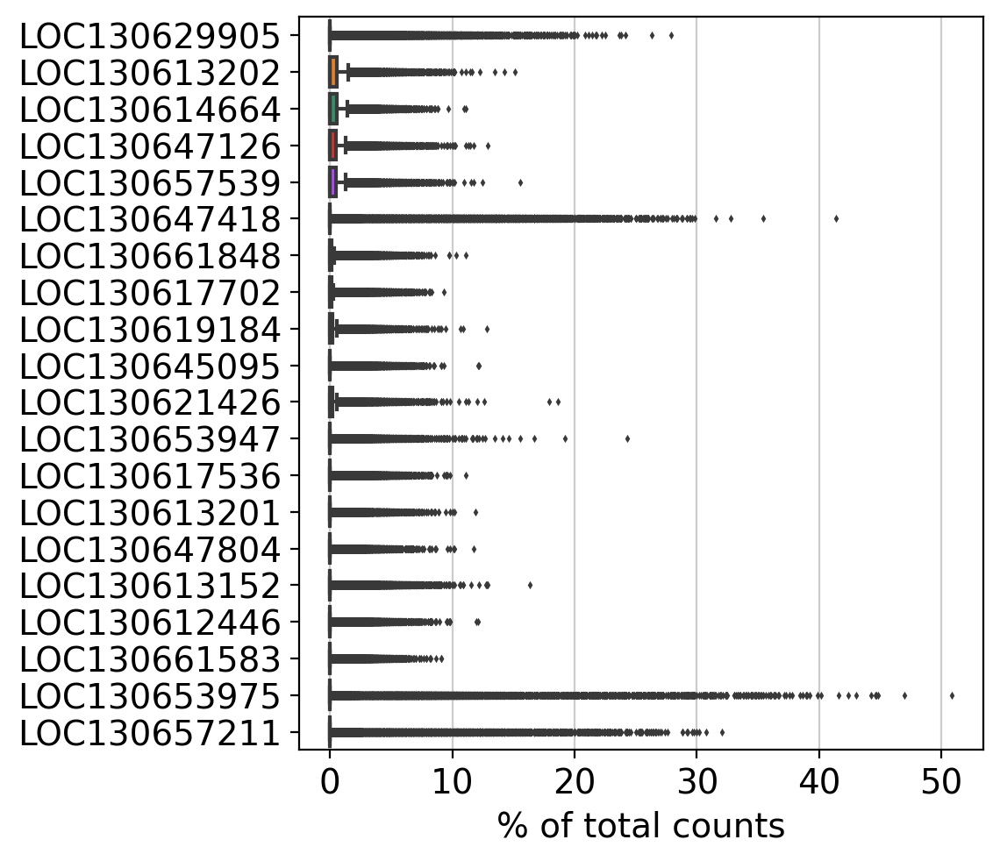

In [ ]:
sc.pl.highest_expr_genes((mdata.mod['no']), n_top=20, save = False)# this is after normalize and logarithmizise in another notebook

In [ ]:
sc.pp.filter_cells((mdata.mod['no']), min_counts=50)
sc.pp.filter_cells((mdata.mod['no']), min_genes= 50)

filtered out 27511 cells that have less than 50 counts
filtered out 13650 cells that have less than 50 genes expressed


In [ ]:
(mdata.mod['no']).var

,ratio_with_no
LOC130612030,1.119558
LOC130612032,1.109701
LOC130612033,1.346984
LOC130612034,1.429284
LOC130612035,1.428458
...,...
Trnaw-cca_167,1.071283
Trnay-gua_152,1.060409
Trnay-gua_17,1.315169
Trnay-gua_247,1.071283


normalizing counts per cell
    finished (0:00:00)


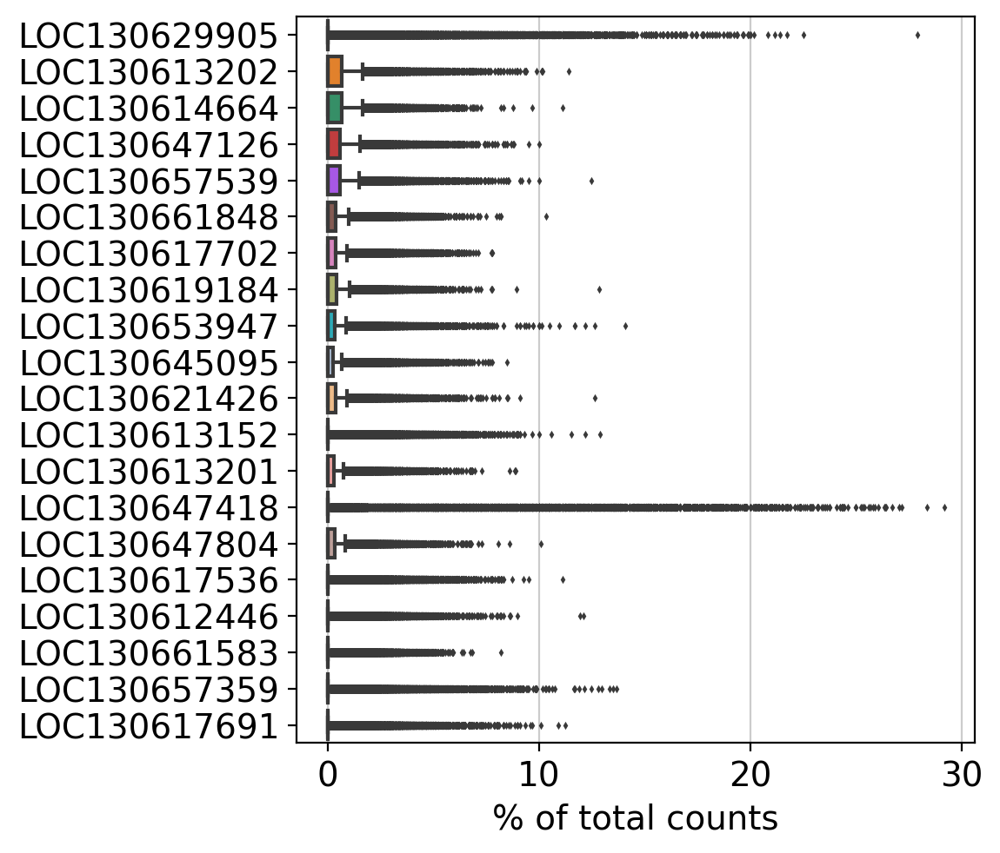

In [ ]:
sc.pl.highest_expr_genes((mdata.mod['no']), n_top=20, save = False)

In [ ]:
(mdata.mod['no']).var['mt'] = (mdata.mod['no']).var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics((mdata.mod['no']), qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

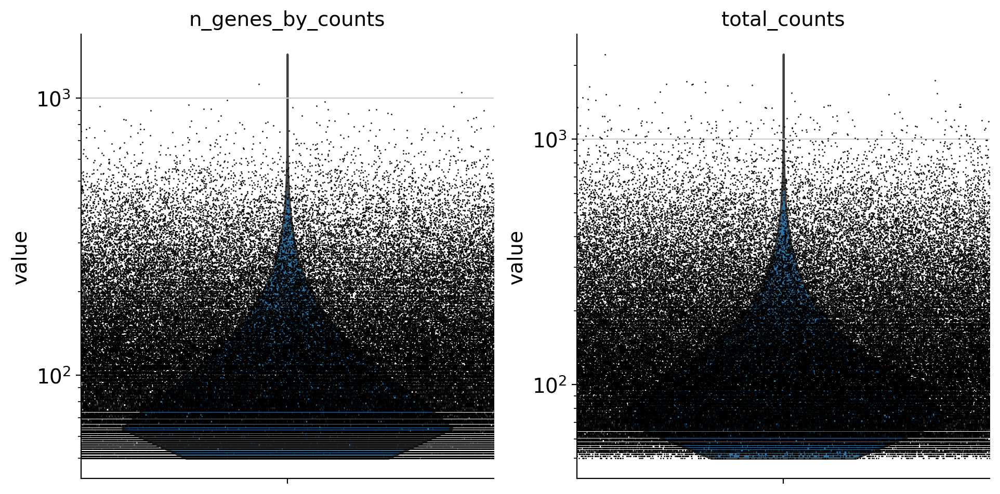

In [ ]:
sc.pl.violin((mdata.mod['no']), ['n_genes_by_counts', 'total_counts'],
             jitter= 0.7, multi_panel=True, log = True, save = False)

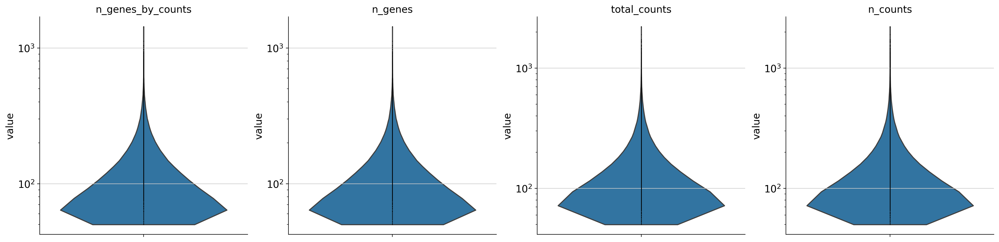

In [ ]:
sc.pl.violin((mdata.mod['no']), ['n_genes_by_counts','n_genes','total_counts','n_counts'],
             jitter= False, multi_panel=True, log = True, save = False)

In [ ]:
(mdata.mod['no']).obs.groupby('Library').describe()

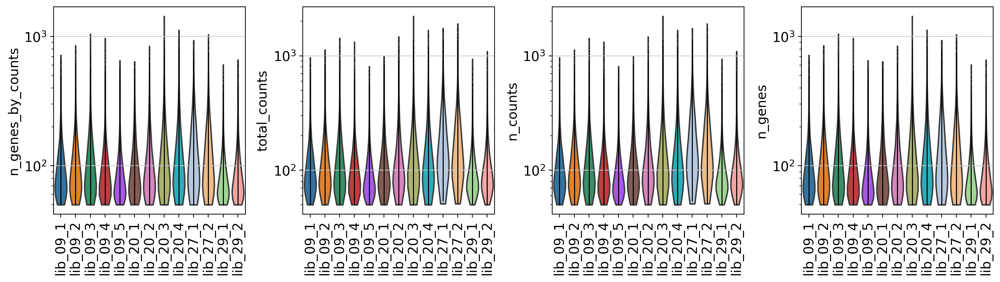

In [ ]:
sc.pl.violin((mdata.mod['no']), ['n_genes_by_counts', 'total_counts','n_counts','n_genes'],groupby='Library',
             jitter= False, multi_panel=True, log = True,
             save = False, rotation=90)

In [ ]:
mdata

### Matrix slicing

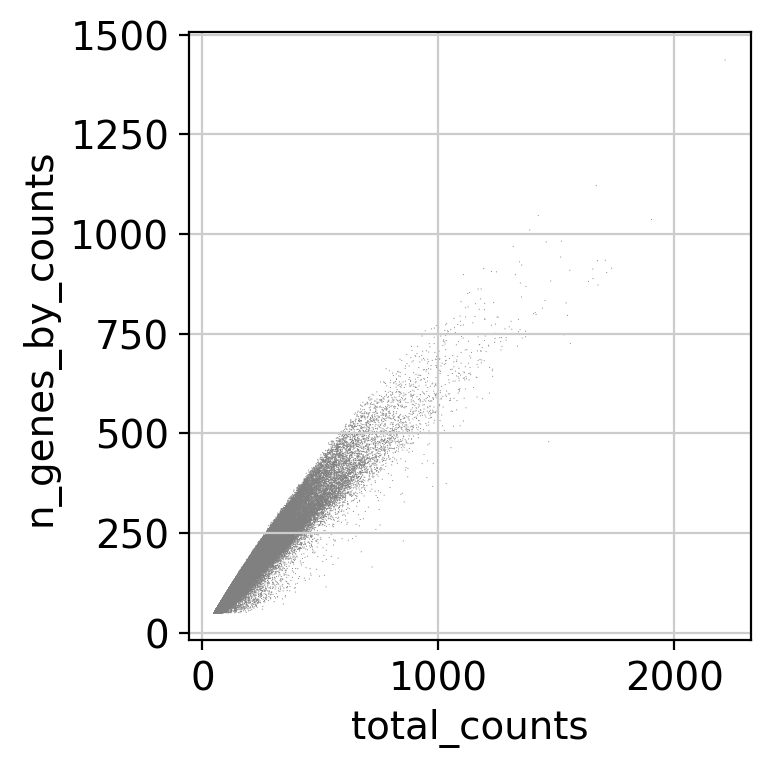

In [ ]:
sc.pl.scatter((mdata.mod['no']), x='total_counts', y='n_genes_by_counts')

In [ ]:
(mdata.mod['no']) = (mdata.mod['no'])[(mdata.mod['no']).obs.n_genes_by_counts < 700, :]

In [ ]:
(mdata.mod['no']) = (mdata.mod['no'])[(mdata.mod['no']).obs.total_counts < 750, :]

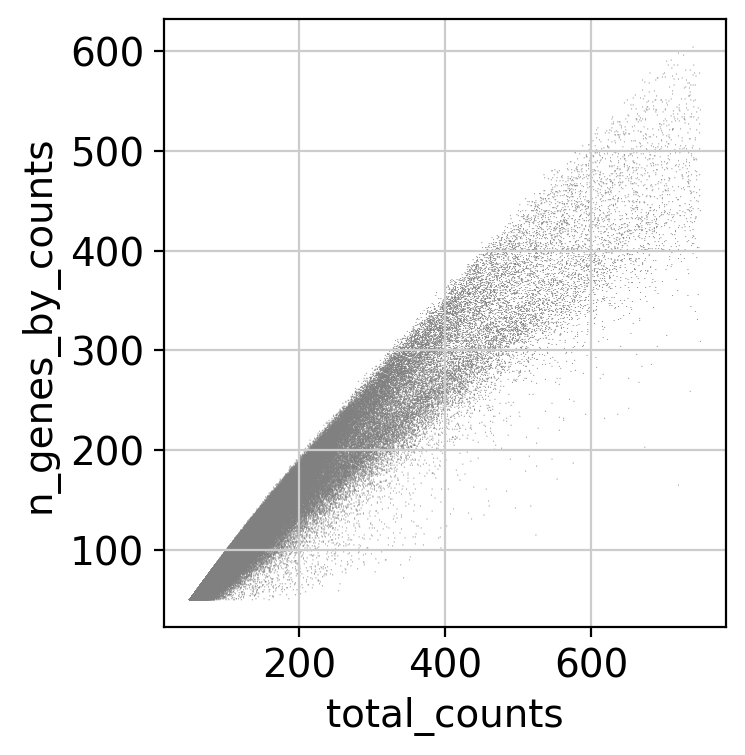

In [ ]:
sc.pl.scatter((mdata.mod['no']), x='total_counts', y='n_genes_by_counts', save = False)

### Normalization and log transformation

The following 2 functions normalise and log transform the matrix

In [ ]:
sc.pp.normalize_total((mdata.mod['no']), target_sum=1e4)

In [ ]:
sc.pp.log1p((mdata.mod['no']))

In [ ]:
mdata

### Selecting highly variable genes

In [ ]:
sc.pp.highly_variable_genes((mdata.mod['no']), n_top_genes = 18000)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    Gene indices [7877] fell into a single bin: their normalized dispersion was set to 1.
    Decreasing `n_bins` will likely avoid this effect.
    the 18000 top genes correspond to a normalized dispersion cutoff of -0.571245213489485
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [ ]:
(mdata.mod['no']).raw = (mdata.mod['no'])

In [ ]:
(mdata.mod['no']) = (mdata.mod['no'])[:, (mdata.mod['no']).var.highly_variable]

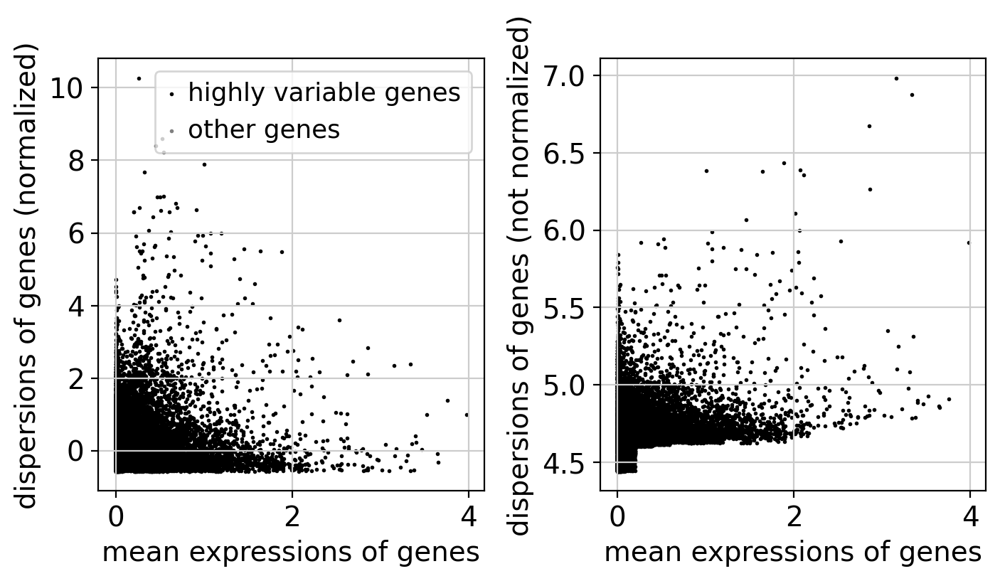

In [ ]:
sc.pl.highly_variable_genes((mdata.mod['no']), save = False)

In [ ]:
mdata

MuData object with n_obs × n_vars = 277529 × 45070
  2 modalities
    with:	277529 x 23126
      obs:	'Experiment', 'Library', 'Body_part', 'Kind_of_polyp', 'Presence_of_PEG', 'batch', 'Unique'
      var:	'ratio_with_no'
    no:	199113 x 18061
      obs:	'Experiment', 'Library', 'Body_part', 'Kind_of_polyp', 'Presence_of_PEG', 'batch', 'Unique', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
      var:	'ratio_with_no', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
      uns:	'Library_colors', 'log1p', 'hvg'

In [ ]:
(mdata.mod['no']).raw.var

,ratio_with_no,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm
LOC130612030,1.119558,False,10,0.000050,99.995004,10.0,True,0.004273,4.748613,0.593155
LOC130612032,1.109701,False,811,0.004536,99.594863,908.0,False,0.202365,4.530117,-1.160862
LOC130612033,1.346984,False,125,0.000664,99.937556,133.0,True,0.052288,4.743840,0.575159
LOC130612034,1.429284,False,201,0.001179,99.899590,236.0,True,0.068646,4.772200,0.682099
LOC130612035,1.428458,False,520,0.002733,99.740232,547.0,True,0.178418,4.663227,0.271175
...,...,...,...,...,...,...,...,...,...,...
Trnaw-cca_167,1.071283,False,1,0.000005,99.999500,1.0,True,0.000636,4.840893,0.941132
Trnay-gua_152,1.060409,False,5,0.000025,99.997502,5.0,True,0.001554,4.499506,-0.346198
Trnay-gua_17,1.315169,False,2,0.000010,99.999001,2.0,True,0.000808,4.788746,0.744493
Trnay-gua_247,1.071283,False,1,0.000005,99.999500,1.0,False,0.000167,3.503230,-4.103045


### Scaling the data

In [ ]:
sc.pp.scale((mdata.mod['no']))#centering by zero

/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


### Performing the PCA and kNN analysis

In [ ]:
sc.tl.pca((mdata.mod['no']), svd_solver='arpack', n_comps = 100)

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:05:51)
    and added
    'X_pca', the PCA coordinates (adata.obs)
    'PC1', 'PC2', ..., the loadings (adata.var)
    'pca_variance', the variance / eigenvalues (adata.uns)
    'pca_variance_ratio', the variance ratio (adata.uns)


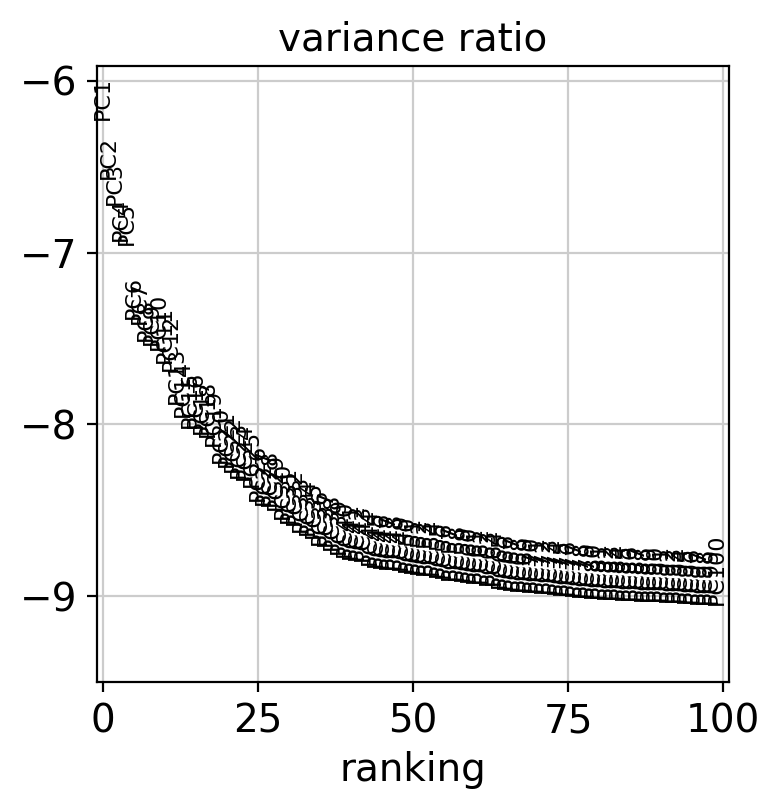

In [ ]:
sc.pl.pca_variance_ratio((mdata.mod['no']), n_pcs=100, log=True, save = False)

### Harmonization, always make it after calculating pca's and before doing clustering

In [ ]:
sce.pp.harmony_integrate((mdata.mod['no']), 'batch', basis='X_pca')
#you can harmonize by the name of adata.obs/mdata.mod['no'].obs that you prefer

2023-07-12 15:02:15,881 - harmonypy - INFO - Iteration 1 of 10
2023-07-12 15:04:34,270 - harmonypy - INFO - Iteration 2 of 10
2023-07-12 15:06:44,121 - harmonypy - INFO - Converged after 2 iterations


In [ ]:
mdata

### Building a clustering layer and corresponding cell neighbors

In [ ]:
sc.pp.neighbors((mdata.mod['no']), n_neighbors=40, n_pcs=75, use_rep='X_pca_harmony')

computing neighbors
        initialized `.distances` `.connectivities` 
    computing neighbors
    computed neighbors (0:00:40)
    computed connectivities (0:00:10)
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:52)


In [ ]:
sc.tl.umap((mdata.mod['no']), min_dist=0.1, spread =0.5)

computing UMAP


  0%|          | 0/200 [00:00<?, ?it/s]

    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:04:07)


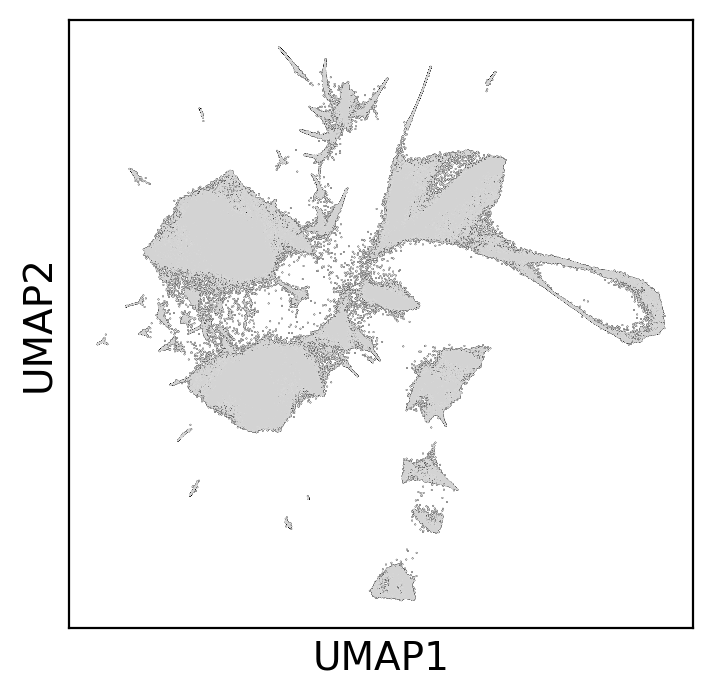

In [ ]:
sc.pl.umap((mdata.mod['no']), add_outline=True)

### Clustering

In [ ]:
resolutions = [1, 1.5, 2]

running Leiden clustering
    finished: found 47 clusters and added
    'leiden_1', the cluster labels (adata.obs, categorical) (0:03:28)


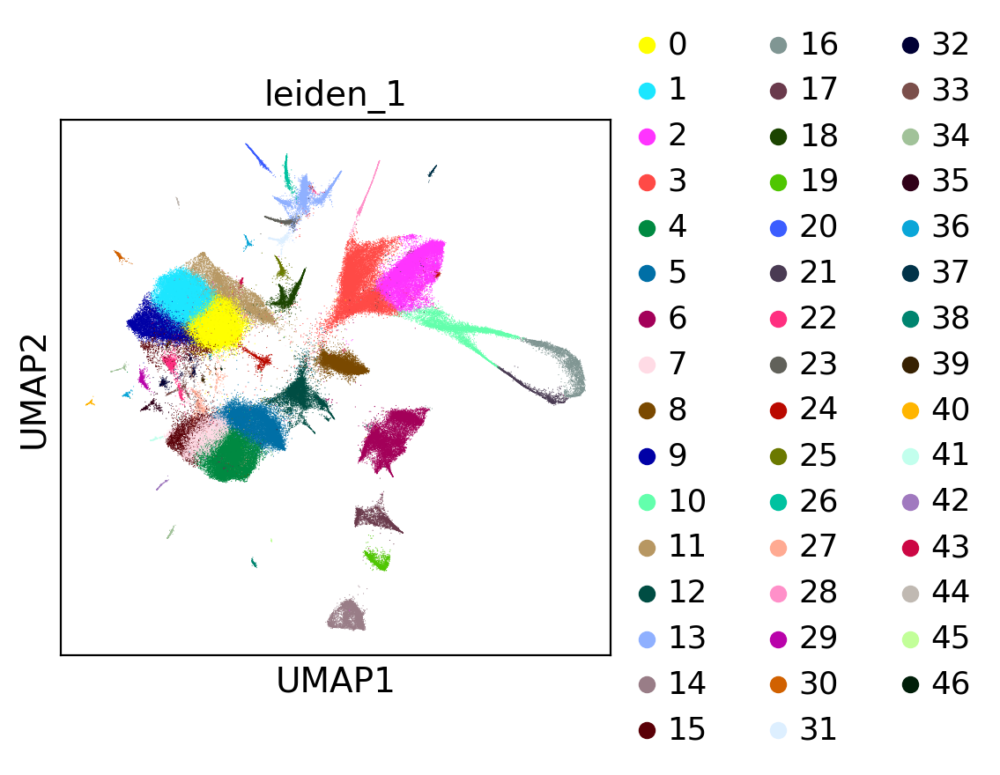

running Leiden clustering
    finished: found 53 clusters and added
    'leiden_1.5', the cluster labels (adata.obs, categorical) (0:05:13)


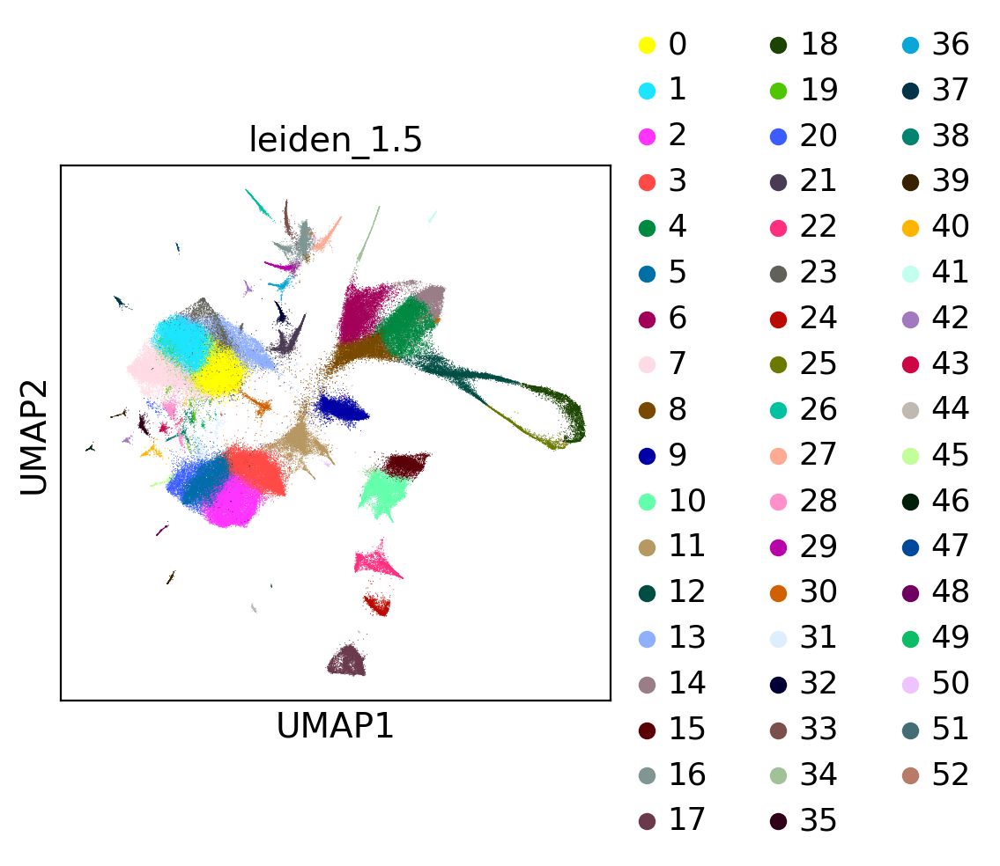

running Leiden clustering
    finished: found 57 clusters and added
    'leiden_2', the cluster labels (adata.obs, categorical) (0:04:31)


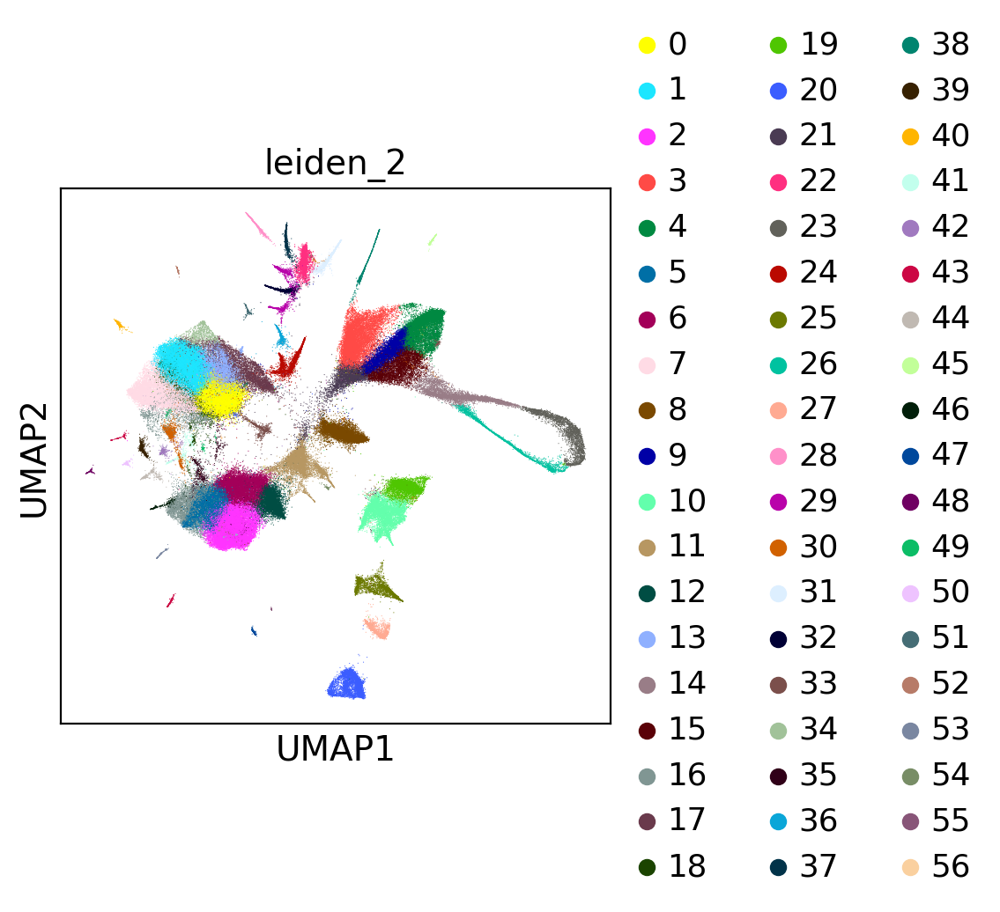

In [ ]:
for i in resolutions:
    sc.tl.leiden((mdata.mod['no']), resolution = i, key_added = 'leiden_'+str(i))
    sc.pl.umap((mdata.mod['no']), color='leiden_'+str(i), title= 'leiden_'+str(i), na_in_legend=False)

In [ ]:
leiden_names = (mdata.mod['no']).obs.columns[(mdata.mod['no']).obs.columns.str.contains('leiden')].to_list()

In [ ]:
leiden_names

['leiden_1', 'leiden_1.5', 'leiden_2']

ranking genes
    consider 'leiden_1' groups:
    with sizes: [24279 18133 17560 16950 14981 13730 11322 10252  7280  6896  6388  6285
  6184  5803  4019  3615  3043  2726  2694  1854  1523  1440  1367  1112
   932   890   881   850   720   571   516   516   484   455   424   413
   389   371   333   219   194   139   121    95    94    51    19]


/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmente

    finished: added to `.uns['rank_genes_groups_wilcox_leiden_1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:07:42)


/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals'] = pvals[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented. 

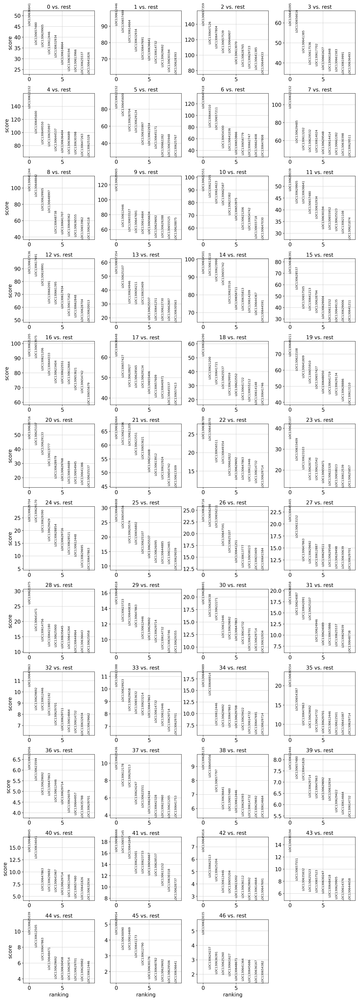

ranking genes
    consider 'leiden_1.5' groups:
    with sizes: [20479 16708 14008 12806 12663 11531  9598  8945  7577  7273  6850  6131
  6067  4824  4798  4404  4336  4020  3027  2964  2898  2841  2736  2631
  1859  1750  1525  1425  1423  1114  1041   902   902   890   726   607
   514   507   460   432   428   391   378   346   333   321   252   131
   122    82    67    51    19]


/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmente

/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals'] = pvals[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This 

    finished: added to `.uns['rank_genes_groups_wilcox_leiden_1.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:07:41)


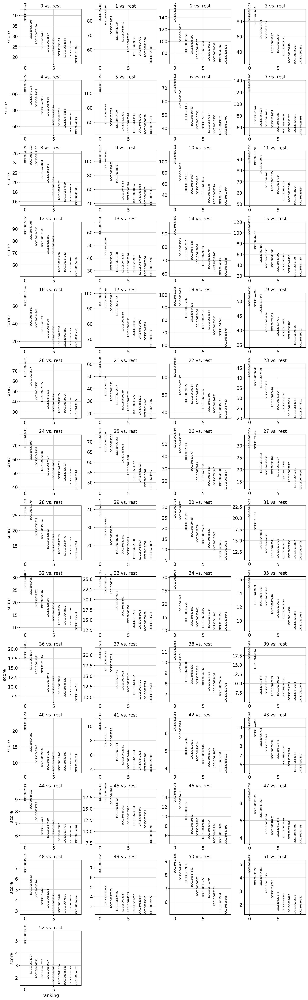

ranking genes
    consider 'leiden_2' groups:
    with sizes: [16059 14890 13379  9730  9173  9104  9022  8076  7256  6966  6836  6007
  5729  5371  5170  5027  4988  4807  4714  4421  4077  3909  3384  3027
  2867  2749  2557  1866  1538  1537  1446  1430  1171  1129  1045   928
   903   890   726   605   515   467   435   434   419   397   339   333
   255   231   213   172   135   122    66    52    19]


/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmente

/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:409: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'pvals_adj'] = pvals_adj[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:420: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  Thi

    finished: added to `.uns['rank_genes_groups_wilcox_leiden_2']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:07:50)


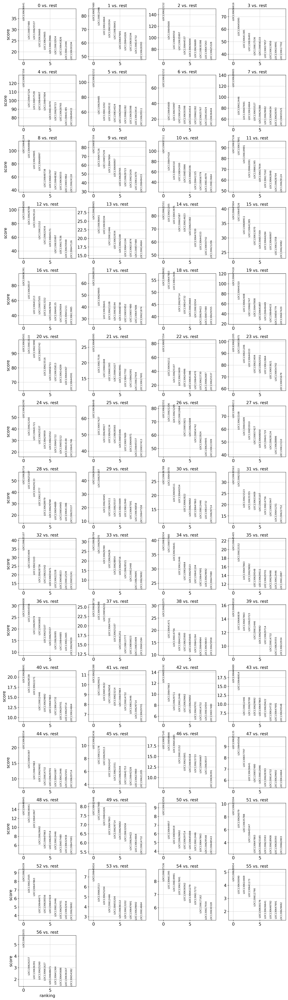

In [ ]:
for leiden_i in leiden_names:
    sc.tl.rank_genes_groups((mdata.mod['no']), leiden_i, method='wilcoxon', key_added = 'rank_genes_groups_wilcox_'+str(leiden_i))
    sc.pl.rank_genes_groups((mdata.mod['no']), key='rank_genes_groups_wilcox_'+str(leiden_i), n_genes = 10, sharey = False)

ranking genes
    consider 'leiden_1' groups:
    with sizes: [24279 18133 17560 16950 14981 13730 11322 10252  7280  6896  6388  6285
  6184  5803  4019  3615  3043  2726  2694  1854  1523  1440  1367  1112
   932   890   881   850   720   571   516   516   484   455   424   413
   389   371   333   219   194   139   121    95    94    51    19]


/mnt/sda/david/.local/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


    finished: added to `.uns['rank_genes_groups_logreg_leiden_1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:04:09)


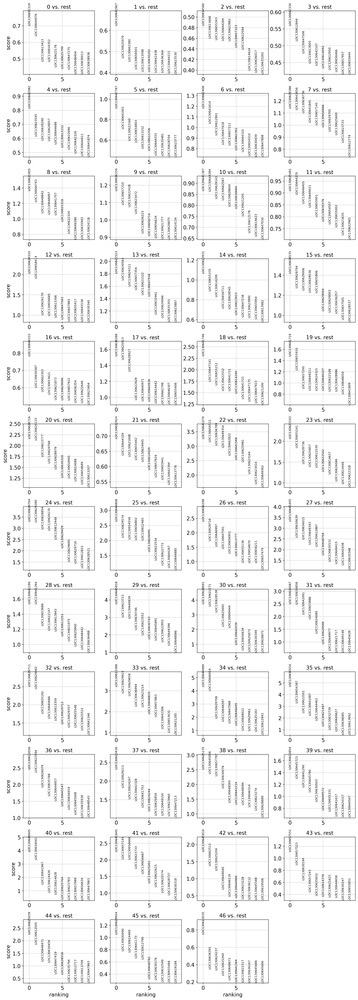

ranking genes
    consider 'leiden_1.5' groups:
    with sizes: [20479 16708 14008 12806 12663 11531  9598  8945  7577  7273  6850  6131
  6067  4824  4798  4404  4336  4020  3027  2964  2898  2841  2736  2631
  1859  1750  1525  1425  1423  1114  1041   902   902   890   726   607
   514   507   460   432   428   391   378   346   333   321   252   131
   122    82    67    51    19]


/mnt/sda/david/.local/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-pack

    finished: added to `.uns['rank_genes_groups_logreg_leiden_1.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:04:38)


/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]


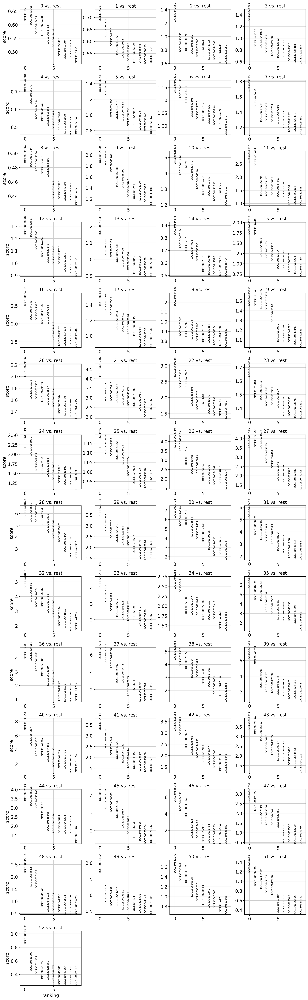

ranking genes
    consider 'leiden_2' groups:
    with sizes: [16059 14890 13379  9730  9173  9104  9022  8076  7256  6966  6836  6007
  5729  5371  5170  5027  4988  4807  4714  4421  4077  3909  3384  3027
  2867  2749  2557  1866  1538  1537  1446  1430  1171  1129  1045   928
   903   890   726   605   515   467   435   434   419   397   339   333
   255   231   213   172   135   122    66    52    19]


/mnt/sda/david/.local/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/mnt/sda/david/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/mnt/sda/david/.local/lib/python3.8/site-pack

    finished: added to `.uns['rank_genes_groups_logreg_leiden_2']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
 (0:05:15)


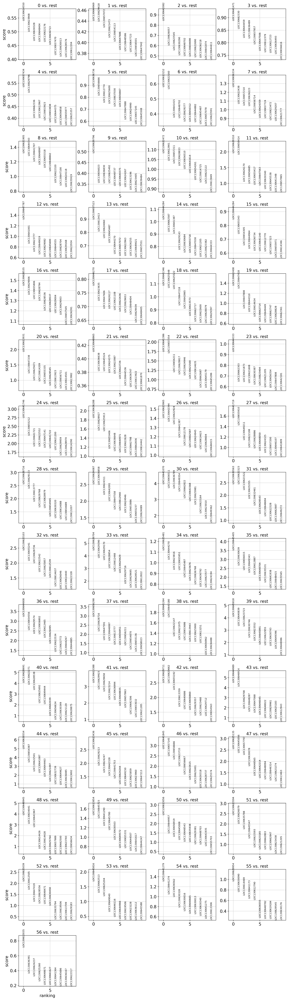

In [ ]:
for leiden_i in leiden_names:
    sc.tl.rank_genes_groups((mdata.mod['no']), leiden_i, method='logreg', key_added = 'rank_genes_groups_logreg_'+str(leiden_i))
    sc.pl.rank_genes_groups((mdata.mod['no']), key='rank_genes_groups_logreg_'+str(leiden_i), n_genes = 10, sharey = False)

In [ ]:
sc.get.rank_genes_groups_df((mdata.mod['no']), group=None, key='rank_genes_groups_wilcox_leiden_1', pval_cutoff=0.05, log2fc_min=None)

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,LOC130636641,45.435738,2.391090,0.000000e+00,0.000000e+00
1,0,LOC130657480,36.614544,1.908409,1.678732e-293,1.674459e-290
2,0,LOC130629905,35.621666,1.380538,6.472781e-278,5.463027e-275
3,0,LOC130612446,32.289570,1.213414,9.799803e-229,6.516572e-226
4,0,LOC130632934,30.734177,1.766282,1.989847e-207,1.180140e-204
...,...,...,...,...,...,...
16667,44,LOC130625039,9.644543,18.046078,5.184198e-22,1.137620e-17
16668,44,LOC130612505,8.037215,32.568707,9.190334e-16,1.008363e-11
16669,44,LOC130647863,6.394829,3.627603,1.607272e-10,1.175666e-06
16670,44,LOC130648471,5.179539,31.193275,2.224354e-07,1.220281e-03


In [ ]:
wc= sc.get.rank_genes_groups_df((mdata.mod['no']), group=None, key='rank_genes_groups_wilcox_leiden_1', pval_cutoff=0.05, log2fc_min=None)

In [ ]:
pd.options.display.max_rows=2000
wc['group'].value_counts()

2     2699
4     1557
1     1524
3     1124
0     1105
6      856
7      834
9      748
12     690
5      596
10     577
16     522
13     428
8      393
11     374
14     371
21     355
15     346
17     202
19     171
20     137
18     126
27     108
28      99
22      94
23      82
26      76
29      59
30      54
35      50
25      44
33      42
32      32
34      32
39      31
41      29
31      28
24      22
38      15
43      11
40      10
36       8
37       5
44       4
42       1
46       1
45       0
Name: group, dtype: int64

### Some markers for sanity and integrity check of the current version of the umap

In [ ]:
markers_dic={'PIWI1':'LOC130623353',
            'Rfamide':'LOC130657354',
            'ELAV': 'LOC130630562',
            'GLWamide':'LOC130624311',
            'Sperm-associated antigen 16':'LOC130622507',
            'H2B.4 spermatogenesis marker': 'LOC130656616',
            'Tubulin alpha 1 chain': 'LOC130641471',
            'Myosin 4 -like': 'LOC130621975',
            'Ncol1':'LOC130622551',
            'Nematocyte':'LOC130644310',
            'epithelial venomous':'LOC130644743',
            'feeding':'LOC130635948',
            'Stolon':'LOC130630016',
            'epitheliomuscular':'LOC130649617',
            'epithelial_1':'LOC130621489',
            'epithelial_2':'LOC130642088',
            'epithelial_3':'LOC130645256'}

In [ ]:
markers_id=list(markers_dic.values())
markers_names=list(markers_dic.keys())

In [ ]:
df= ((mdata.mod['no']).var[(mdata.mod['no']).var.index.isin(markers_id)])

In [ ]:
minusdf = (mdata.mod['no']).var[~(mdata.mod['no']).var.index.isin(markers_id)]

In [ ]:
dft= (mdata.mod['no']).raw.var[(mdata.mod['no']).raw.var.index.isin(markers_id)]

In [ ]:
list(set(markers_dic.values())-set(dft.index))

[]

In [ ]:
minusdf

,ratio_with_no,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm,mean,std
LOC130612030,1.119558,False,10,0.000050,99.995004,10.0,True,4.273221e-03,4.748613,0.593155,0.000216,0.030688
LOC130612033,1.346984,False,125,0.000664,99.937556,133.0,True,5.228799e-02,4.743840,0.575159,0.002655,0.107926
LOC130612034,1.429284,False,201,0.001179,99.899590,236.0,True,6.864602e-02,4.772200,0.682099,0.003954,0.128323
LOC130612035,1.428458,False,520,0.002733,99.740232,547.0,True,1.784180e-01,4.663227,0.271175,0.010625,0.212273
LOC130612036,1.145483,False,12870,0.074044,93.570754,14822.0,True,1.815345e+00,4.691698,-0.360676,0.267720,1.040346
...,...,...,...,...,...,...,...,...,...,...,...,...
Trnav-cac_103,1.071283,False,0,0.000000,100.000000,0.0,True,1.000000e-12,NaN,NaN,0.000000,1.000000
Trnaw-cca_146,1.071283,False,0,0.000000,100.000000,0.0,True,1.000000e-12,NaN,NaN,0.000000,1.000000
Trnaw-cca_167,1.071283,False,1,0.000005,99.999500,1.0,True,6.355289e-04,4.840893,0.941132,0.000024,0.010866
Trnay-gua_152,1.060409,False,5,0.000025,99.997502,5.0,True,1.554264e-03,4.499506,-0.346198,0.000086,0.019270


In [ ]:
df

,ratio_with_no,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm,mean,std
LOC130621489,1.100843,False,1154,0.006169,99.423516,1235.0,True,0.376855,4.709336,0.311671,0.024100,0.321115
LOC130621975,1.158590,False,1779,0.015022,99.111295,3007.0,True,0.915036,5.753440,6.642292,0.042452,0.456344
LOC130622507,1.331337,False,2077,0.012544,98.962429,2511.0,True,0.667805,4.916270,1.539387,0.043896,0.439778
LOC130622551,1.097070,False,9857,0.146794,95.075907,29385.0,True,2.535012,5.926827,3.603161,0.251939,1.125761
LOC130623353,1.101357,False,5345,0.035913,97.329890,7189.0,True,0.959730,4.627838,-0.536736,0.098454,0.624858
LOC130624311,1.100076,False,425,0.004401,99.787690,881.0,True,0.324515,5.605717,7.676670,0.010613,0.231656
LOC130630016,1.114321,False,1306,0.014217,99.347584,2846.0,True,0.697453,5.628726,6.705819,0.031002,0.387005
LOC130630562,1.091518,False,2679,0.014612,98.661698,2925.0,True,0.726255,4.726270,0.161582,0.055518,0.485994
LOC130635948,1.080412,False,6571,0.057663,96.717438,11543.0,True,1.354454,4.889864,0.716330,0.138408,0.766330
LOC130641471,1.136089,False,3025,0.020037,98.488852,4011.0,True,1.093743,5.281767,2.588768,0.070720,0.576829


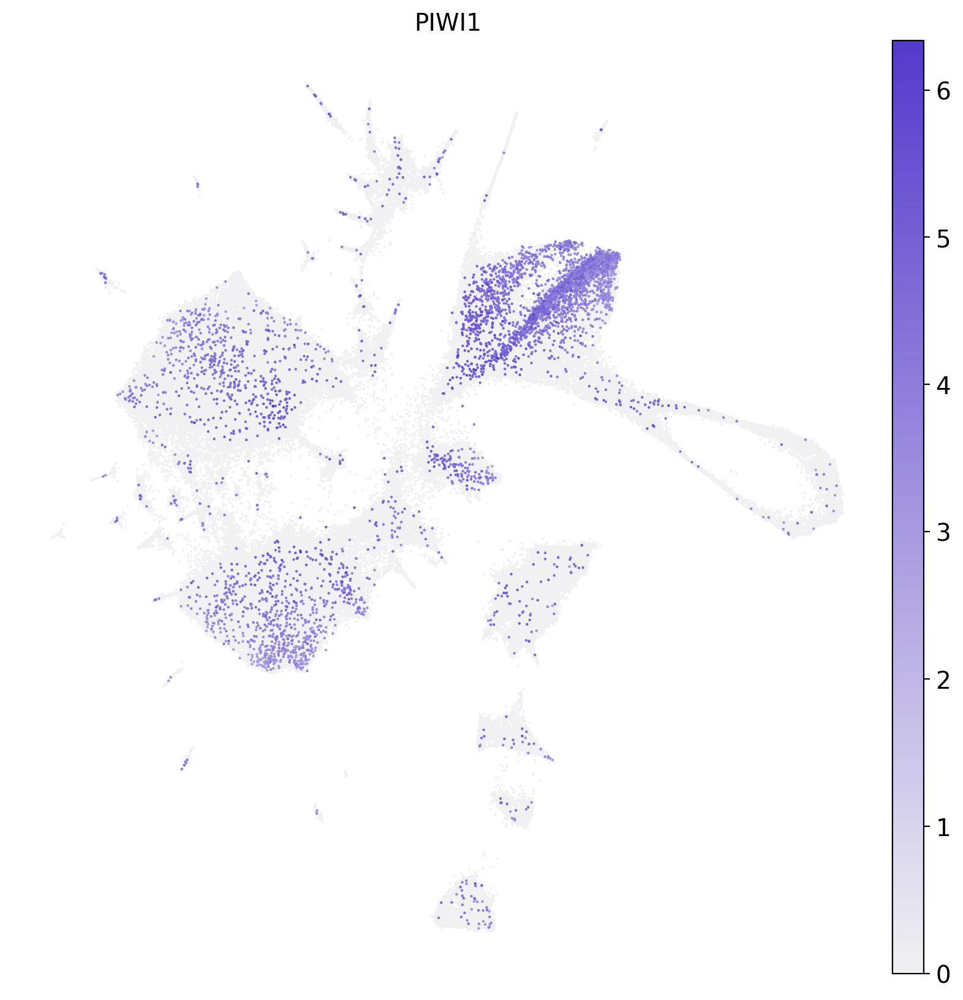

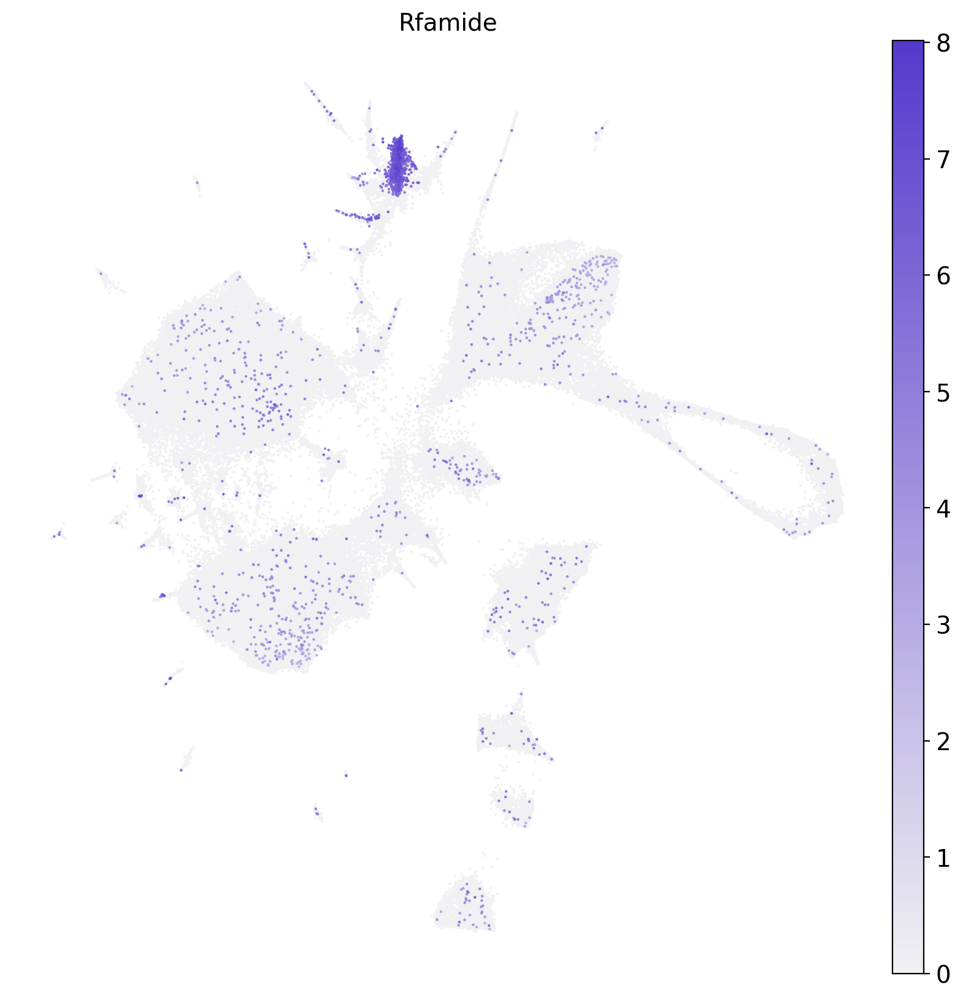

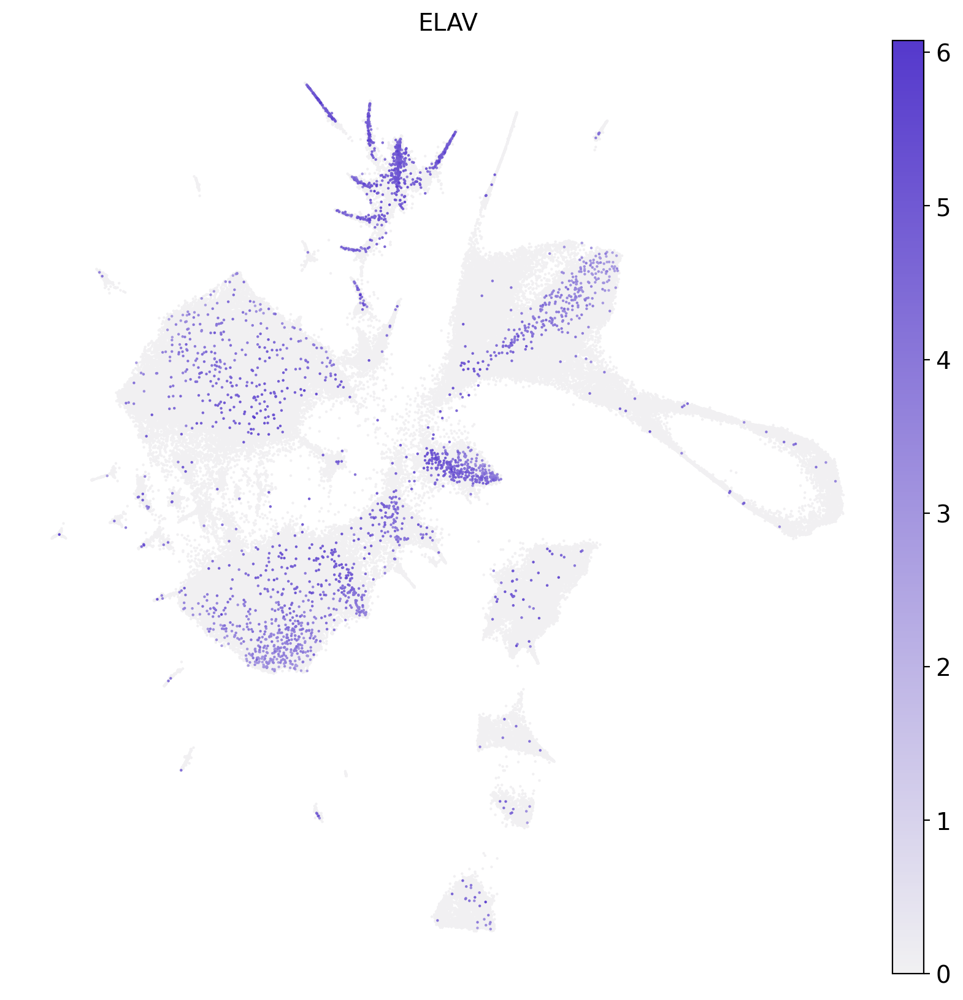

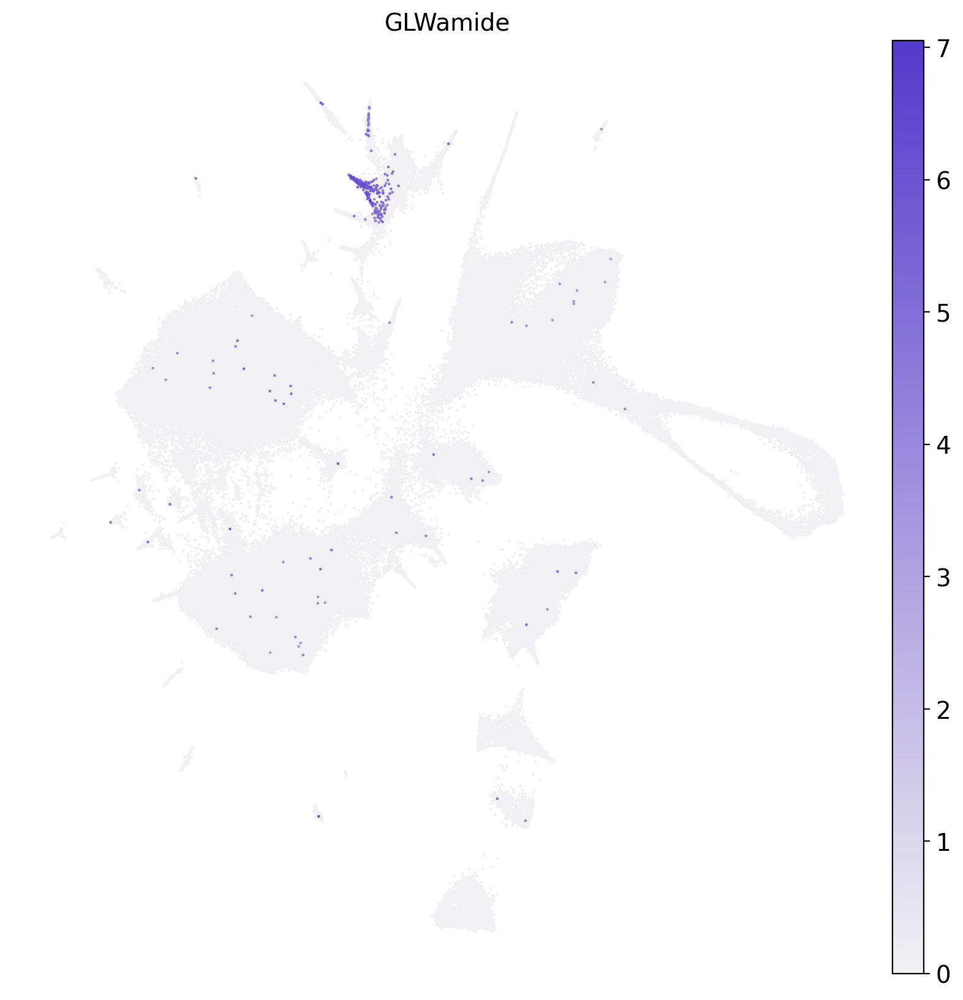

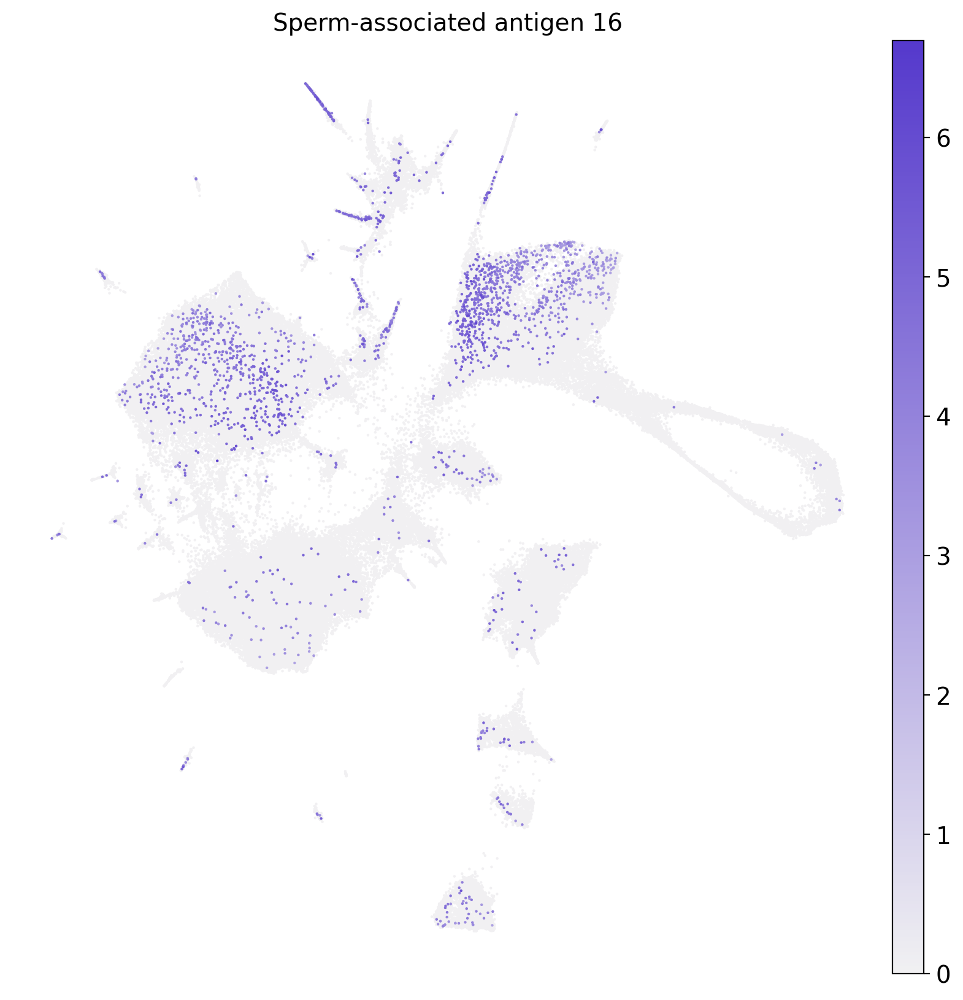

...

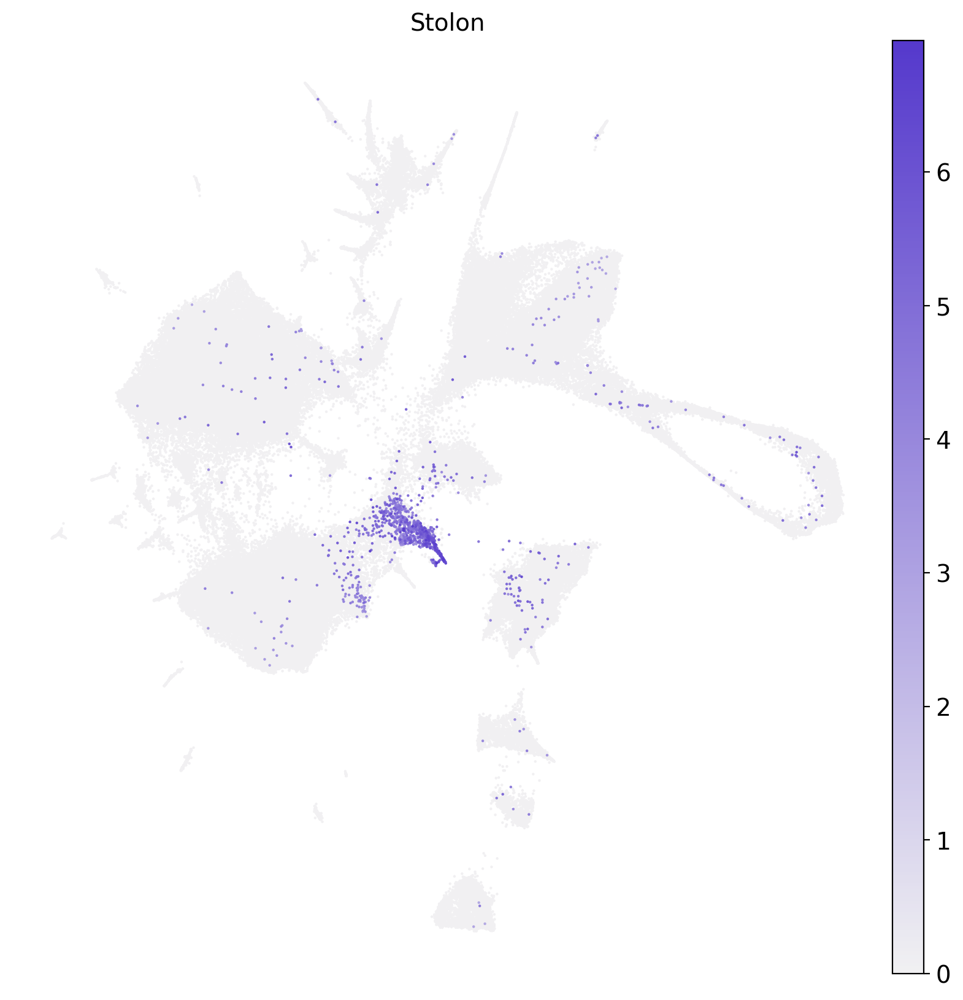

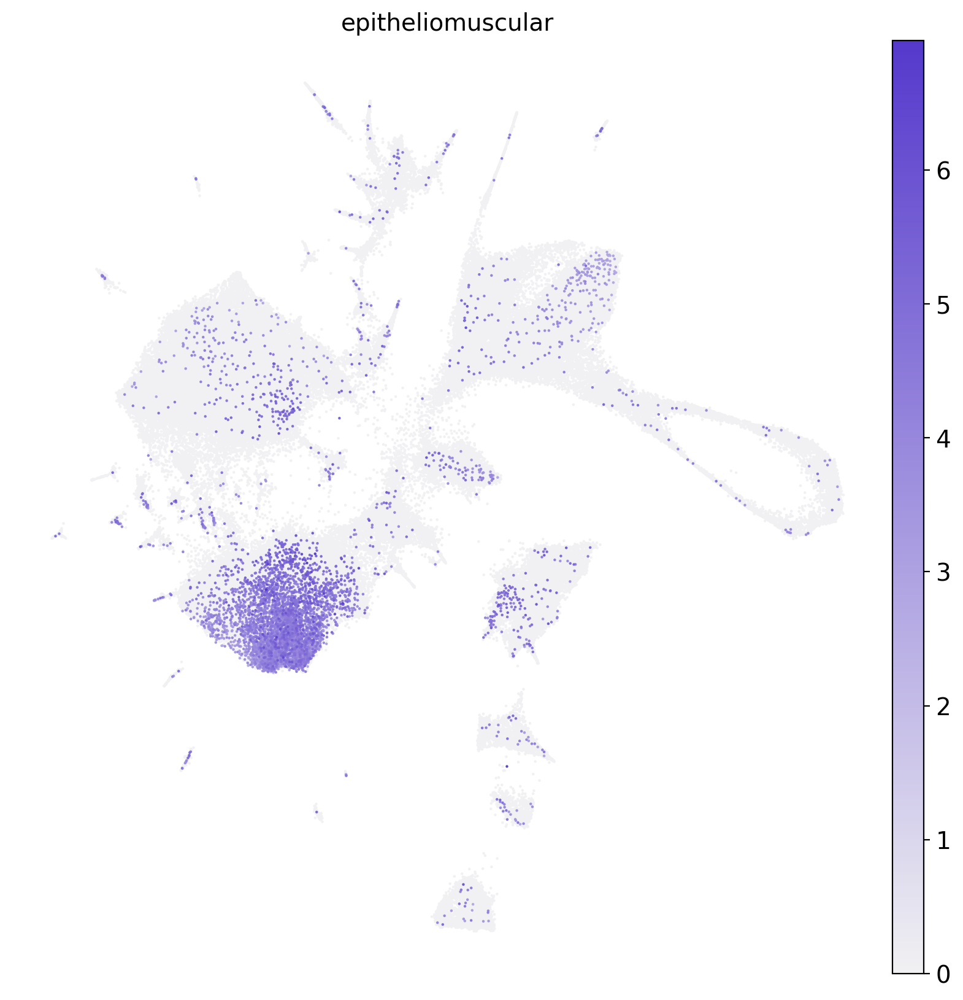

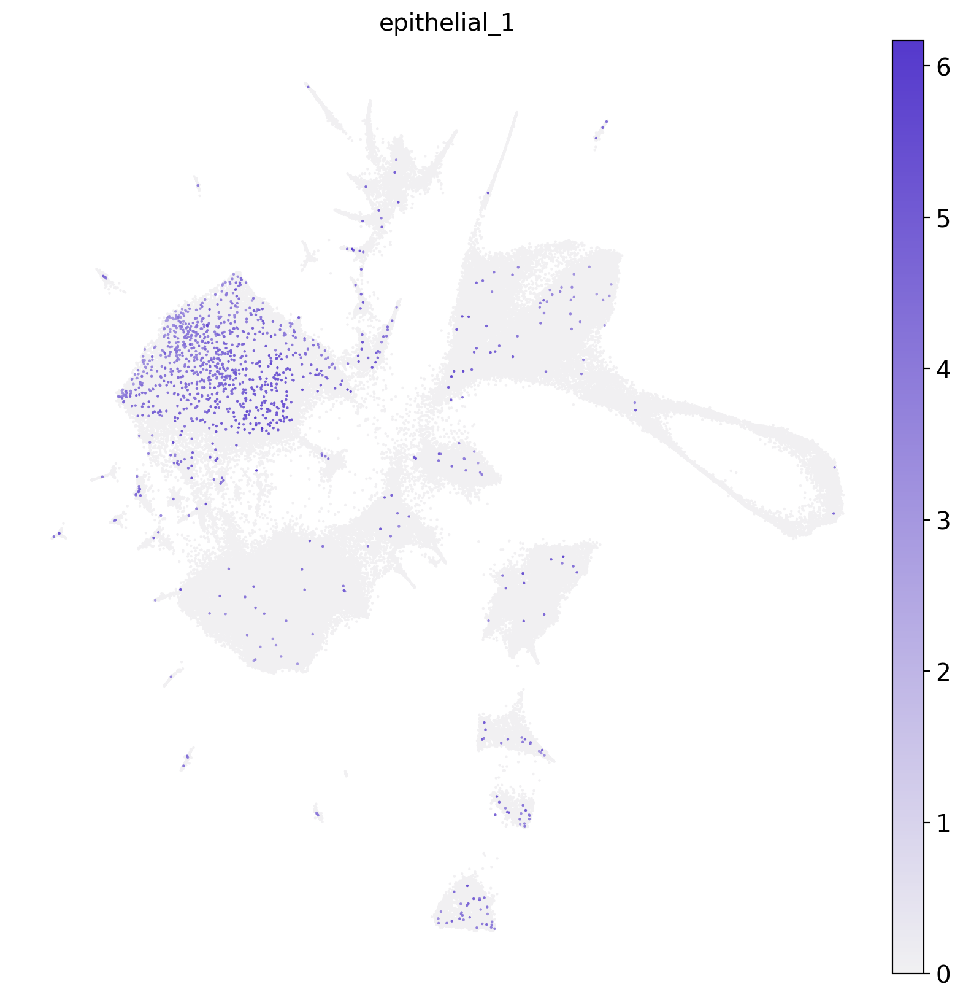

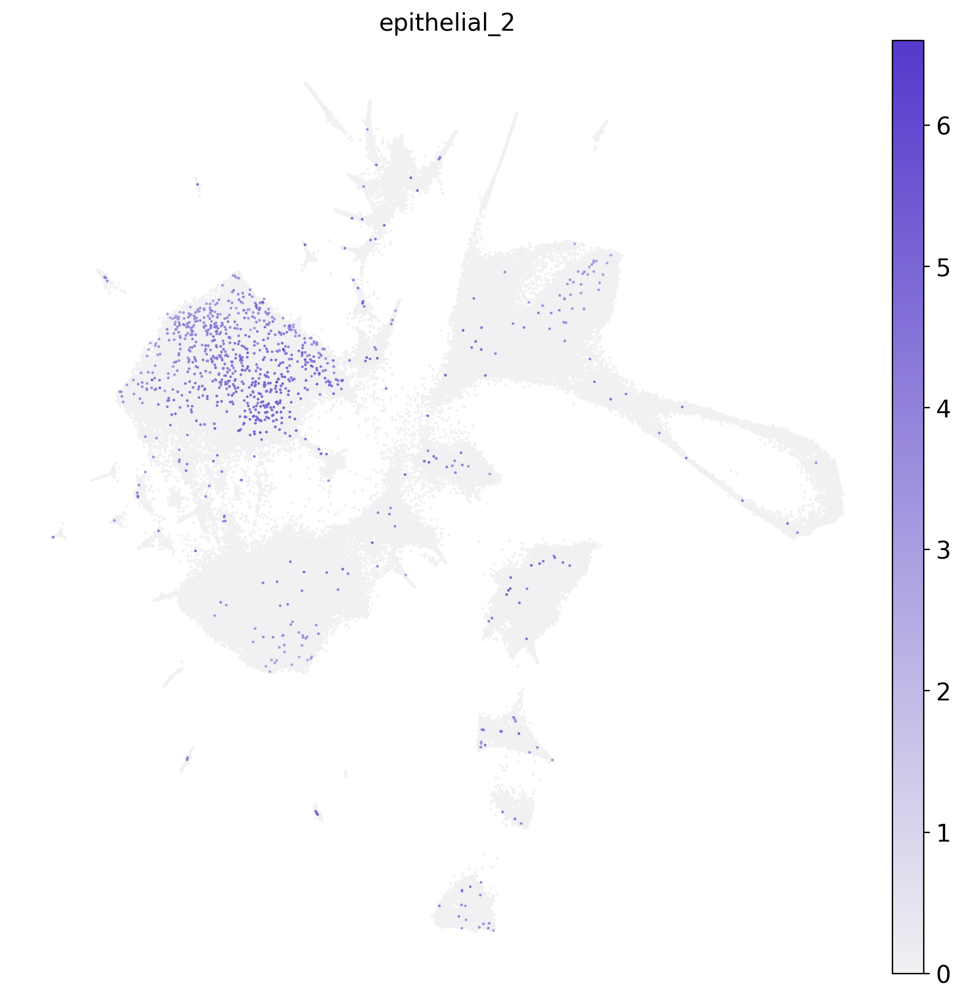

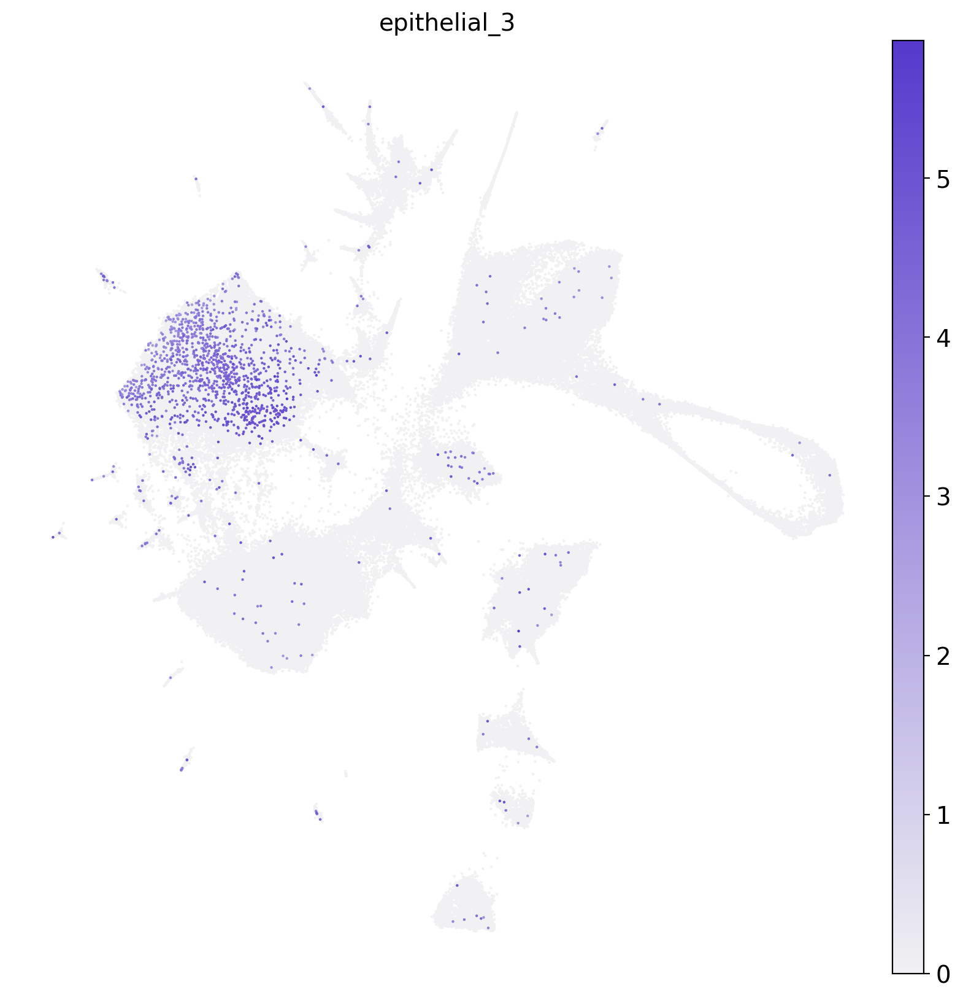

In [ ]:
with rc_context({'figure.figsize': (10, 10)}):
    for i in range(len(markers_dic)):
        sc.pl.umap((mdata.mod['no']), color=markers_id[i], title= markers_names[i], ncols=3,
                   color_map = umap_cmap,size= 10, na_in_legend=False, frameon=False)

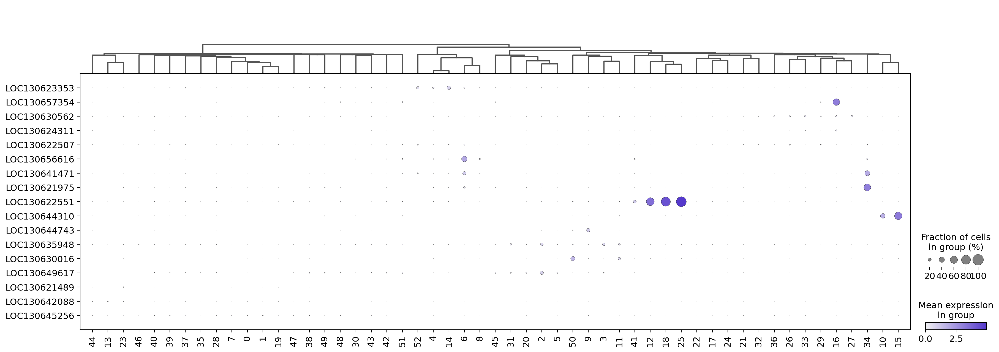

In [ ]:
sc.pl.dotplot((mdata.mod['no']), markers_id, groupby='leiden_1.5', dendrogram=True, swap_axes = True, cmap = umap_cmap)

In [ ]:
(mdata.mod['no']).obs

In [ ]:
mdata.write("$PATH/hydractinia/hydractinia_atlas_20230712.h5mu")

/mnt/sda/david/.local/lib/python3.8/site-packages/mudata/_core/mudata.py:457: UserWarning: Cannot join columns with the same name because var_names are intersecting.
  warnings.warn(
